In [5]:
import librosa
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd

audio_path = '/Users/aleccandidato/Projects/Supporters/audio/Still_Into_You-Paramore(Acapella).mp3'
audio, sr = librosa.load(audio_path, sr=None) # sr=None preserves the original sample rate

print(audio.shape)
print(sr)
ipd.Audio(audio, rate=sr)


(9844463,)
48000


In [7]:
# Create a DataFrame from the audio data
import pandas as pd

# Create a DataFrame with the audio samples
df = pd.DataFrame({
    'amplitude': audio
})

# Display the first few rows of the DataFrame
print(df)

# Display basic information about the DataFrame
print("\nDataFrame Info:")
print(df.info())

         amplitude
0         0.000000
1         0.000000
2         0.000000
3         0.000000
4         0.000000
...            ...
9844458   0.000141
9844459   0.000635
9844460   0.000179
9844461   0.000143
9844462   0.000451

[9844463 rows x 1 columns]

DataFrame Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9844463 entries, 0 to 9844462
Data columns (total 1 columns):
 #   Column     Dtype  
---  ------     -----  
 0   amplitude  float32
dtypes: float32(1)
memory usage: 37.6 MB
None


In [8]:
datasets = [
    {
        'label': 'Still Into You',
        'data': df
    }
]

In [11]:
Graph = {
    'type': 'stem',
    'title': 'Still Into You (Visualized)',
    'x-label': 'Time (s)',
    'y-label': 'Amplitude',
    'datasets': datasets
}

Grapher = [[Graph]
           ]

1 1


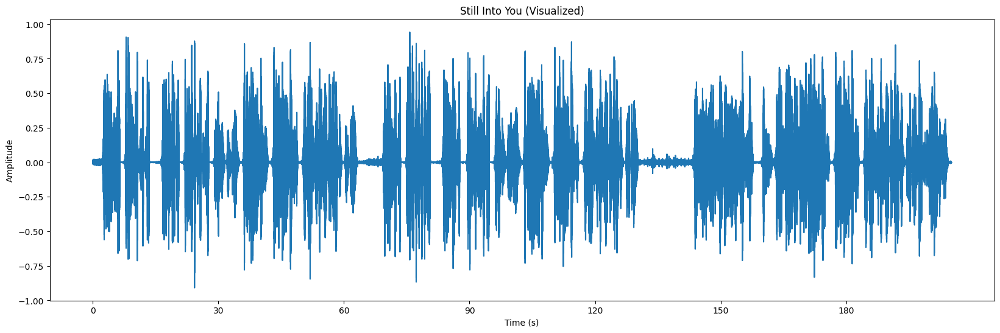

In [28]:
rows = len(Grapher)
columns = len(Grapher[0]) # Should be length of longest list in Grapher
print(rows, columns)

first_graph = Grapher[0][0]
first_graph_datasets = first_graph['datasets']
first_plot_dataframe = first_graph_datasets[0]['data']

# Create time array in seconds
time = np.arange(len(first_plot_dataframe)) / sr

fig, axs = plt.subplots(rows, columns, figsize=(20, 6))

""" Only use this notation when multiple plots are needed """
# axs[0, 0].plot(first_plot_dataframe)
# axs[0, 0].set_title(first_graph['title'])
# axs[0, 0].set_xlabel(first_graph['x-label'])
# axs[0, 0].set_ylabel(first_graph['y-label'])

axs.plot(time, first_plot_dataframe)
axs.set_title(first_graph['title'])
axs.set_xlabel(first_graph['x-label'])
axs.set_ylabel(first_graph['y-label'])

# Set x-axis ticks every 30 seconds
max_time = len(first_plot_dataframe) / sr
axs.set_xticks(np.arange(0, max_time, 30))

plt.show()

In [34]:
import librosa
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd
import pandas as pd

class Audio:
    def __init__(self, audio_path, listen=False):
        self.audio_path = audio_path
        self.audio, self.sr = librosa.load(self.audio_path, sr=None) #sr=None preserves the original sample rate
        self.original_df = pd.DataFrame({'amplitude': self.audio})
        
        self.time = np.arange(len(self.original_df)) / self.sr
        # Create a new DataFrame with both amplitude and time data
        self.seconds_df = pd.DataFrame({
            'amplitude': self.audio,
            'time': self.time
        })

        if listen:
            ipd.Audio(self.audio, rate=self.sr)

    def convert_to_dataframe(self):
        return {
            'original_df': self.original_df,
            'sample_rate': self.sr,
        }, self.seconds_df

In [36]:
audio_path = '/Users/aleccandidato/Projects/Supporters/audio/Still_Into_You-Paramore(Acapella).mp3'

still_into_you = Audio(audio_path)

og_df, time_df = still_into_you.convert_to_dataframe()
print(time_df)

         amplitude        time
0         0.000000    0.000000
1         0.000000    0.000021
2         0.000000    0.000042
3         0.000000    0.000063
4         0.000000    0.000083
...            ...         ...
9844458   0.000141  205.092875
9844459   0.000635  205.092896
9844460   0.000179  205.092917
9844461   0.000143  205.092938
9844462   0.000451  205.092958

[9844463 rows x 2 columns]


In [1]:
from Audio import Audio

audio_path = '/Users/aleccandidato/Projects/Supporters/audio/Still_Into_You-Paramore(Acapella).mp3'
still_into_you = Audio(audio_path)

In [2]:
og_df, time_df = still_into_you.convert_to_dataframe()
print(time_df)

         amplitude        time
0         0.000000    0.000000
1         0.000000    0.000021
2         0.000000    0.000042
3         0.000000    0.000063
4         0.000000    0.000083
...            ...         ...
9844458   0.000141  205.092875
9844459   0.000635  205.092896
9844460   0.000179  205.092917
9844461   0.000143  205.092938
9844462   0.000451  205.092958

[9844463 rows x 2 columns]


Text(0.5, 1.0, 'Still Into You - Paramore')

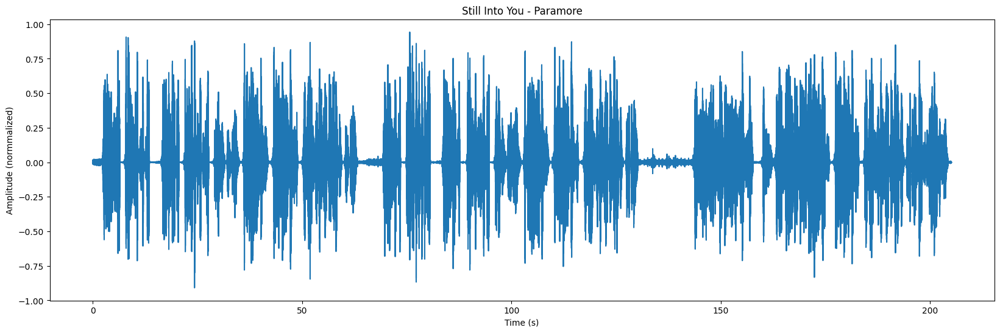

In [10]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(20, 6))
ax.plot(time_df["time"], time_df["amplitude"])
ax.set_ylabel("Amplitude (normmalized)")
ax.set_xlabel("Time (s)")
ax.set_title("Still Into You - Paramore")